In [9]:
import sys
sys.path.insert(0,'/home/marvin/code/MarvinLiebisch/forecasting-electricity-prices/energy_price_predictions/ml_logic')

In [12]:
from data_import import import_merged_data

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np

plt.style.use('default')
%matplotlib inline
pd.options.mode.chained_assignment = None  # default='warn'

In [13]:
df = import_merged_data()

Importing energy_dataset data from /home/marvin/code/MarvinLiebisch/forecasting-electricity-prices/raw_data/energy_dataset.csv...
Importing weather_features data from /home/marvin/code/MarvinLiebisch/forecasting-electricity-prices/raw_data/weather_features.csv...


In [16]:
df_price = df[['price_day_ahead']]

In [17]:
df_price.head()

,price_day_ahead
time,
2015-01-01 00:00:00+01:00,50.10
2015-01-01 01:00:00+01:00,48.10
2015-01-01 02:00:00+01:00,47.33
2015-01-01 03:00:00+01:00,42.27
2015-01-01 04:00:00+01:00,38.41


In [19]:
df_price['hour'] = df_price.index.hour+1

In [ ]:
df_price_hour8 = df[df['hour'] == 8][['price_day_ahead']]
df_price_hour8['30D_SMA'] = df_price_hour8['price_day_ahead'].rolling(30).mean()
df_price_hour8.dropna(inplace=True)

In [37]:
df_moving_avg_hour = pd.DataFrame(index=np.unique(df_price.index.date))

In [78]:
dict_of_hour_df = {}
for i in range(24):
    key_name = i+1
    df_new = df_price[['price_day_ahead']][df_price['hour'] == i+1]
    df_new['30D_SMA'] = df_new['price_day_ahead'].rolling(30).mean()
    df_new['14D_SMA'] = df_new['price_day_ahead'].rolling(14).mean()
    df_new['7D_SMA'] = df_new['price_day_ahead'].rolling(7).mean()
    df_new['3D_SMA'] = df_new['price_day_ahead'].rolling(3).mean()
    df_new.dropna(inplace=True)
    dict_of_hour_df[key_name] = df_new

In [85]:
def load_data():
    df = import_merged_data()
    df_price = df[['price_day_ahead']]
    df_price['hour'] = df_price.index.hour+1
    df_price['7D_SMA'] = df_price['price_day_ahead'].rolling(24*7).mean()
    df_price['30D_SMA'] = df_price['price_day_ahead'].rolling(24*30).mean()
    df_price.dropna(inplace=True)

    dict_of_hourly_df = {}
    for i in range(24):
        key_name = i+1
        df_new = df_price[['price_day_ahead']][df_price['hour'] == i+1]
        df_new['30D_SMA'] = df_new['price_day_ahead'].rolling(30).mean()
        df_new['14D_SMA'] = df_new['price_day_ahead'].rolling(14).mean()
        df_new['7D_SMA'] = df_new['price_day_ahead'].rolling(7).mean()
        df_new['3D_SMA'] = df_new['price_day_ahead'].rolling(3).mean()
        df_new.dropna(inplace=True)
        dict_of_hourly_df[key_name] = df_new

    return df_price, dict_of_hourly_df


df_price1, dict_of_hourly_df1 = load_data()

Importing energy_dataset data from /home/marvin/code/MarvinLiebisch/forecasting-electricity-prices/raw_data/energy_dataset.csv...
Importing weather_features data from /home/marvin/code/MarvinLiebisch/forecasting-electricity-prices/raw_data/weather_features.csv...


In [89]:
dict_of_hourly_df1[1].columns

Index(['price_day_ahead', '30D_SMA', '14D_SMA', '7D_SMA', '3D_SMA'], dtype='object')

In [91]:
dict_of_hourly_df1[1]['30D_SMA'].name

'30D_SMA'

In [94]:
df.index[-30:]

DatetimeIndex(['2018-12-30 19:00:00+01:00', '2018-12-30 20:00:00+01:00',
               '2018-12-30 21:00:00+01:00', '2018-12-30 22:00:00+01:00',
               '2018-12-30 23:00:00+01:00', '2018-12-31 00:00:00+01:00',
               '2018-12-31 01:00:00+01:00', '2018-12-31 02:00:00+01:00',
               '2018-12-31 03:00:00+01:00', '2018-12-31 04:00:00+01:00',
               '2018-12-31 05:00:00+01:00', '2018-12-31 06:00:00+01:00',
               '2018-12-31 07:00:00+01:00', '2018-12-31 08:00:00+01:00',
               '2018-12-31 09:00:00+01:00', '2018-12-31 10:00:00+01:00',
               '2018-12-31 10:00:00+01:00', '2018-12-31 11:00:00+01:00',
               '2018-12-31 12:00:00+01:00', '2018-12-31 13:00:00+01:00',
               '2018-12-31 14:00:00+01:00', '2018-12-31 15:00:00+01:00',
               '2018-12-31 16:00:00+01:00', '2018-12-31 17:00:00+01:00',
               '2018-12-31 18:00:00+01:00', '2018-12-31 19:00:00+01:00',
               '2018-12-31 20:00:00+01:00', '2018-1

In [79]:
dict_of_hour_df[1]

,price_day_ahead,30D_SMA,14D_SMA,7D_SMA,3D_SMA
time,,,,,
2015-01-30 00:00:00+01:00,20.00,43.932333,41.919286,40.680000,36.006667
2015-01-31 00:00:00+01:00,5.00,42.429000,39.666429,35.107143,23.426667
2015-02-01 00:00:00+01:00,47.34,43.673667,40.459286,36.185714,24.113333
2015-02-02 00:00:00+01:00,42.47,43.902000,40.761429,36.418571,31.603333
2015-02-03 00:00:00+01:00,20.17,43.752667,38.868571,31.857143,36.660000
...,...,...,...,...,...
2018-12-27 00:00:00+01:00,68.52,56.920667,60.556429,64.740000,65.553333
2018-12-28 00:00:00+01:00,67.34,57.130667,61.640714,65.795714,65.600000
2018-12-29 00:00:00+01:00,61.61,57.149667,61.305714,65.580000,65.823333


In [96]:
dict_of_hour_df.keys()

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24])

In [57]:
df_moving_avg_hour_1 = df_price[['price_day_ahead']][df_price['hour'] == 1]

In [ ]:
for i in range(24):
    df_moving_avg_hour[f"Series {i+1}"] = pd.Series(df_price['price_day_ahead'][df_price['hour'] == i+1]).rolling(30).mean()

In [72]:
for i in range(24):
    f"df_moving_avg_hour_{i+1}" = df_price[['price_day_ahead']][df_price['hour'] == i+1]

SyntaxError: cannot assign to f-string expression here. Maybe you meant '==' instead of '='? (3010388839.py, line 2)

In [69]:
for i in range(24):
    df_moving_avg_hour_1['30D_SMA'] = df_moving_avg_hour_1['price_day_ahead'].rolling(30).mean()
    df_moving_avg_hour_1['14D_SMA'] = df_moving_avg_hour_1['price_day_ahead'].rolling(14).mean()
    df_moving_avg_hour_1['7D_SMA'] = df_moving_avg_hour_1['price_day_ahead'].rolling(7).mean()
    df_moving_avg_hour_1.dropna(inplace=True)

In [70]:
df_moving_avg_hour_1.head(15)

,price_day_ahead,30D_SMA,7D_SMA,1D_SMA
time,,,,
2015-02-05 00:00:00+01:00,50.90,43.284333,31.061429,50.90
2015-02-06 00:00:00+01:00,52.95,43.065333,35.768571,52.95
2015-02-07 00:00:00+01:00,60.12,43.436000,43.642857,60.12
2015-02-08 00:00:00+01:00,52.54,43.171667,44.385714,52.54
2015-02-09 00:00:00+01:00,51.50,43.000000,45.675714,51.50
2015-02-10 00:00:00+01:00,58.81,43.186667,51.195714,58.81
2015-02-11 00:00:00+01:00,26.28,41.857000,50.442857,26.28
2015-02-12 00:00:00+01:00,68.88,42.614000,53.011429,68.88
2015-02-13 00:00:00+01:00,59.00,42.979333,53.875714,59.00


In [65]:
df_moving_avg_hour_1.columns

Index(['price_day_ahead', '30D_SMA'], dtype='object')

In [ ]:
df_moving_avg_hour_1['price_day_ahead'].rolling(30).mean()

In [29]:
for i in range(24):
    df_moving_avg_hour[f"Series {i+1}"] = pd.Series(df_price['price_day_ahead'][df_price['hour'] == i+1]).rolling(30).mean()

/tmp/ipykernel_1503/640567943.py:3: FutureWarning: reindexing with a non-unique Index is deprecated and will raise in a future version.
  df_moving_avg_hour[f"Series {i+1}"] = pd.Series(df_price['price_day_ahead'][df_price['hour'] == i+1]).rolling(30).mean()


ValueError: cannot reindex on an axis with duplicate labels

In [38]:
df_moving_avg_hour.head()

""
2015-01-01
2015-01-02
2015-01-03
2015-01-04
2015-01-05


In [21]:
df_moving_avg_hour[f"Series {i+1}"] = 
for i in range (1, 25):
    print(i)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23


In [20]:
df_price['hour'].head()

time
2015-01-01 00:00:00+01:00    1
2015-01-01 01:00:00+01:00    2
2015-01-01 02:00:00+01:00    3
2015-01-01 03:00:00+01:00    4
2015-01-01 04:00:00+01:00    5
Name: hour, dtype: int64

In [40]:
df_price = df[['price_day_ahead']]
df_price['7D_SMA'] = df_price['price_day_ahead'].rolling(24*7).mean()
df_price['30D_SMA'] = df_price['price_day_ahead'].rolling(24*30).mean()
df_price.dropna(inplace=True)


In [69]:
df_price_hour4 = df[df['hour'] == 4][['price_day_ahead']]
df_price_hour4['30D_SMA'] = df_price_hour4['price_day_ahead'].rolling(30).mean()
df_price_hour4.dropna(inplace=True)

In [70]:
df_price_hour8 = df[df['hour'] == 8][['price_day_ahead']]
df_price_hour8['30D_SMA'] = df_price_hour8['price_day_ahead'].rolling(30).mean()
df_price_hour8.dropna(inplace=True)

In [71]:
df_price_hour4.index = df_price_hour4.index.date
df_price_hour8.index = df_price_hour8.index.date

In [72]:
df_price_hour4.head()

,price_day_ahead,30D_SMA
2015-01-30,5.00,34.066333
2015-01-31,4.00,32.919333
2015-02-01,35.99,33.985667
2015-02-02,29.87,34.411333
2015-02-03,12.00,34.314667


In [73]:
df_price_hour8.head()

,price_day_ahead,30D_SMA
2015-01-30,42.59,50.931333
2015-01-31,17.20,50.424667
2015-02-02,57.59,52.109667
2015-02-03,47.05,53.004000
2015-02-04,40.12,53.209333


In [75]:
df_hour_joined = df_price_hour4[['30D_SMA']].join(df_price_hour8[['30D_SMA']], rsuffix="8")

In [77]:
df_hour_joined.head()
df_hour_joined.dropna(inplace=True)

In [79]:
df_hour_joined.head()

,30D_SMA,30D_SMA8
2015-01-30,34.066333,50.931333
2015-01-31,32.919333,50.424667
2015-02-02,34.411333,52.109667
2015-02-03,34.314667,53.004000
2015-02-04,34.207667,53.209333


In [80]:
fig = px.line(df_hour_joined, x=df_hour_joined.index, y=['30D_SMA', '30D_SMA8'], labels={
                     "30D SMA H4": "Price",
                     "time": ""
                 },
                title='Day-ahead Auction Prices')
fig.show()

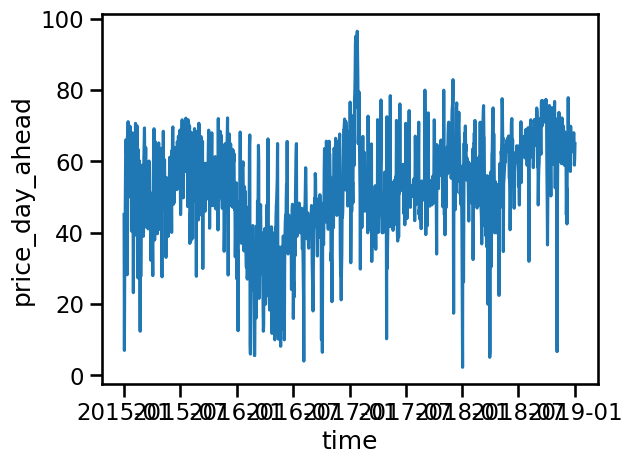

In [ ]:
sns.lineplot(data=df[df['hour'] == 12], x=df[df['hour'] == 12].index, y='price_day_ahead');

In [19]:
fig = px.line(df, x=df.index, y='price_day_ahead', labels={
                     "price_day_ahead": "Price",
                     "time": ""
                 },
                title='Day-ahead Auction Prices')
fig.show()

In [42]:
fig = px.line(df[df['hour'] == 12], x=df[df['hour'] == 12].index, y='price_day_ahead', labels={
                     "price_day_ahead": "Price",
                     "time": ""
                 },
                title='Day-ahead Auction Price for Hour 11-12')
fig.show()

In [23]:


fig = px.line(df_price, x=df_price.index, y=['30D_SMA', 'price_day_ahead'], color_discrete_sequence=['rgba(0, 0, 0, 1)', 
                                                                                                     'rgba(30, 30, 30, 0.1)'])


fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))

newnames = {'30D_SMA':'30D SMA', 'price_day_ahead': 'Hourly Price'}
fig.for_each_trace(lambda t: t.update(name = newnames[t.name],
                                      legendgroup = newnames[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, newnames[t.name])
                                     )
                  )

fig.update_layout(
    title="Average Day-ahead Auction Prices",
    xaxis_title="",
    yaxis_title="Price",
    legend_title=None,
    font=dict(
        family="Arial",
        size=14,
        color="black"
    )
)

fig.show()

In [25]:
fossil = ['generation_fossil_brown_coal/lignite',
       'generation_fossil_gas', 'generation_fossil_hard_coal',
       'generation_fossil_oil']
renewable = ['generation_biomass', 'generation_hydro_pumped_storage_consumption',
       'generation_hydro_run-of-river_and_poundage',
       'generation_hydro_water_reservoir','generation_other_renewable', 'generation_solar',
       'generation_waste', 'generation_wind_onshore']
other = ['generation_other', 'generation_nuclear']

df['fossil'] = df[fossil].sum(axis=1)
df['renewable'] = df[renewable].sum(axis=1)
df['other'] = df[other].sum(axis=1)

In [43]:
df_sources = df[['fossil', 'renewable', 'other', 'price_day_ahead']]
df_sources['30D_price_day_ahead'] = df_sources['price_day_ahead'].rolling(24*30).mean()
df_sources['30D_fossil'] = df_sources['fossil'].rolling(24*30).mean()
df_sources['30D_renewable'] = df_sources['renewable'].rolling(24*30).mean()
df_sources['30D_other'] = df_sources['other'].rolling(24*30).mean()
df_sources.dropna(inplace=True)

In [51]:
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Scatter(
    name = 'Fossil',
    x = df_sources.index,
    y = df_sources['30D_fossil'],
    stackgroup='one',
    line=dict(color="black")
   ))

fig.add_trace(go.Scatter(
    name = 'Renewable',
    x = df_sources.index,
    y = df_sources['30D_renewable'],
    stackgroup='one',
    line=dict(color="green")
   ))

fig.add_trace(go.Scatter(
    name = 'Other',
    x = df_sources.index,
    y = df_sources['30D_other'],
    stackgroup='one',
    line=dict(color="grey")
   ))
    
    

    
fig.add_trace(
    go.Scatter(x=df_sources.index, y=df_sources['30D_price_day_ahead'], name="Price", mode="lines", line=dict(color="#40ff00")),
    secondary_y=True)
    
fig.update_xaxes(title_text="")

# Set y-axes titles
fig.update_yaxes(title_text="Energy Generation", secondary_y=False)
fig.update_yaxes(title_text="Price", secondary_y=True)

fig.for_each_trace(lambda trace: trace.update(fillcolor = trace.line.color))

fig.show()